In [1]:
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
import matplotlib.patches as mpatches
import matplotlib.gridspec as gridspec
import numpy as np
from pyuvdata import UVCal, UVData, UVFlag
import os
import sys
import glob
import uvtools as uvt
from astropy.time import Time
from astropy.coordinates import EarthLocation, SkyCoord, AltAz, Angle
import pandas
import warnings 
import copy
from hera_notebook_templates import utils
import hera_qm
from hera_mc import cm_hookup
import h5py
from uvtools import dspec
import importlib
from matplotlib import colors
from scipy import stats
import scipy
from bokeh.layouts import row, column
from bokeh.models import CustomJS, Select, RadioButtonGroup, Range1d
from bokeh.plotting import figure, output_file, show, ColumnDataSource
#warnings.filterwarnings('ignore')

%matplotlib inline
%config InlineBackend.figure_format = 'retina'


In [2]:
#get data location
# JD = os.environ['JULIANDATE']
# data_path = os.environ['DATA_PATH']
JD = 2459144
data_path = '/lustre/aoc/projects/hera/lberkhou/2459144'
utc = Time(JD, format='jd').datetime
print(f'JD = {JD}')
print(f'Date = {utc.month}-{utc.day}-{utc.year}')
print(f'data_path = "{data_path}"')

JD = 2459144
Date = 10-21-2020
data_path = "/lustre/aoc/projects/hera/lberkhou/2459144"


In [69]:
bls = (82, 130, 'nn'), (82, 130, 'ee'), (82, 135, 'nn'), (82, 135, 'ee'), (82, 148, 'nn'), (82, 148, 'ee'), (82, 110, 'nn'), (82, 110, 'ee'), (82, 189, 'nn'), (82, 189, 'ee'), (82, 129, 'nn'), (82, 129, 'ee'), (82, 149, 'nn'), (82, 149, 'ee'), (82, 143, 'nn'), (82, 143, 'ee'), (82, 82, 'nn'), (82, 82, 'ee'), (82, 83, 'nn'), (82, 83, 'ee'), (82, 98, 'nn'), (82, 98, 'ee'), (82, 190, 'nn'), (82, 190, 'ee'), (82, 127, 'nn'), (82, 127, 'ee'), (82, 147, 'nn'), (82, 147, 'ee'), (82, 170, 'nn'), (82, 170, 'ee'), (82, 128, 'nn'), (82, 128, 'ee'), (82, 168, 'nn'), (82, 168, 'ee'), (82, 191, 'nn'), (82, 191, 'ee'), (82, 73, 'nn'), (82, 73, 'ee'), (82, 169, 'nn'), (82, 169, 'ee'), (82, 144, 'nn'), (82, 144, 'ee'), (82, 4, 'nn'), (82, 4, 'ee'), (82, 176, 'nn'), (82, 176, 'ee'), (82, 5, 'nn'), (82, 5, 'ee'), (82, 177, 'nn'), (82, 177, 'ee'), (82, 163, 'nn'), (82, 163, 'ee'), (82, 164, 'nn'), (82, 164, 'ee'), (82, 165, 'nn'), (82, 165, 'ee'), (82, 178, 'nn'), (82, 178, 'ee'), (82, 179, 'nn'), (82, 179, 'ee'), (82, 184, 'nn'), (82, 184, 'ee'), (82, 45, 'nn'), (82, 45, 'ee'), (82, 81, 'nn'), (82, 81, 'ee'), (82, 185, 'nn'), (82, 185, 'ee'), (82, 46, 'nn'), (82, 46, 'ee'), (82, 186, 'nn'), (82, 186, 'ee'), (82, 116, 'nn'), (82, 116, 'ee'), (82, 109, 'nn'), (82, 109, 'ee'), (82, 93, 'nn'), (82, 93, 'ee'), (82, 94, 'nn'), (82, 94, 'ee'), (82, 92, 'nn'), (82, 92, 'ee'), (82, 155, 'nn'), (82, 155, 'ee'), (82, 145, 'nn'), (82, 145, 'ee'), (82, 187, 'nn'), (82, 187, 'ee'), (82, 14, 'nn'), (82, 14, 'ee'), (82, 23, 'nn'), (82, 23, 'ee'), (82, 24, 'nn'), (82, 24, 'ee'), (82, 25, 'nn'), (82, 25, 'ee'), (82, 26, 'nn'), (82, 26, 'ee'), (82, 3, 'nn'), (82, 3, 'ee'), (82, 39, 'nn'), (82, 39, 'ee'), (82, 85, 'nn'), (82, 85, 'ee'), (82, 86, 'nn'), (82, 86, 'ee'), (82, 87, 'nn'), (82, 87, 'ee'), (82, 166, 'nn'), (82, 166, 'ee'), (82, 111, 'nn'), (82, 111, 'ee'), (82, 112, 'nn'), (82, 112, 'ee'), (82, 120, 'nn'), (82, 120, 'ee'), (82, 122, 'nn'), (82, 122, 'ee'), (82, 136, 'nn'), (82, 136, 'ee'), (82, 137, 'nn'), (82, 137, 'ee'), (82, 138, 'nn'), (82, 138, 'ee'), (82, 99, 'nn'), (82, 99, 'ee'), (82, 100, 'nn'), (82, 100, 'ee'), (82, 101, 'nn'), (82, 101, 'ee'), (82, 102, 'nn'), (82, 102, 'ee'), (82, 103, 'nn'), (82, 103, 'ee'), (82, 104, 'nn'), (82, 104, 'ee'), (82, 117, 'nn'), (82, 117, 'ee'), (82, 118, 'nn'), (82, 118, 'ee'), (82, 119, 'nn'), (82, 119, 'ee')

In [70]:
# Load in data
HHfiles, difffiles, HHautos, diffautos, uvdx, uvdy = utils.load_data(data_path,JD)
    
uvd = UVData()
uvd_diff = UVData()
unread = True
i=0
while unread and i<len(HHautos):
    try:
        uvd.read(HHautos[i])
        unread = False
    except:
        i += 1
        continue
print('Reading Sums')
uvd.read(HHfiles[100:260], skip_bad_files=True, bls=bls)
print('Reading Diffs')
uvd_diff.read(difffiles[100:260], skip_bad_files=True, bls=bls)
lsts = uvd.lst_array

1862 sum files found between JDs 2459144.25108 and 2459144.66738
1862 diff files found between JDs 2459144.25108 and 2459144.66738
1862 sum auto files found between JDs 2459144.25108 and 2459144.66738
1862 diff auto files found between JDs 2459144.25108 and 2459144.66738
Reading Sums
Reading Diffs


In [71]:
len(bls)

142

In [73]:
print('Flagging')
flagfile = glob.glob(os.path.join(HHfiles[0].split('zen')[0],'*total_stage_1_threshold_flags.h5'))    
uvf = UVFlag()
uvf.read(flagfile)
times_uvf = np.unique(uvf.time_array)
print(times_uvf.shape)
times_uvd = np.unique(uvd.time_array)
print(times_uvd.shape)
idx_times = [np.where(time_uvd == times_uvf)[0][0] for time_uvd in times_uvd]
print(len(idx_times))
print(uvd.flag_array.shape)
try:
    uvd.flag_array[:,0,:,:] = np.repeat(uvf.flag_array[idx_times], len(bls)//2+1, axis=0)
except:
    uvd.flag_array[:,0,:,:] = np.repeat(uvf.flag_array[idx_times], len(bls)//2, axis=0)

Flagging
(3724,)
(320,)
320
(22720, 1, 1536, 2)


In [ ]:
importlib.reload(utils)

In [74]:
_data_cleaned_sq, data_rs_sq = utils.clean_ds(HHfiles[100:260], bls, uvd, uvd_diff, pols=['nn','ee'])

In [75]:
jd = 2459144
outdir = '/lustre/aoc/projects/hera/dstorer/Projects/highDelayFeature/loadAnalysis/Ant82'
for bl in bls:
    title = f'{bl[0]}_{bl[1]}_{bl[2]}.pdf'
    print(title)
    auto_waterfall_lineplot(uvd, bl, jd, auto_update, auto_flagged_update, ds_update, dff_update,
                                taus, _data_cleaned_sq, colorbar_min=1e6, colorbar_max=1e8, title=title,
                                outdir=outdir)

82_130_nn.pdf
82_130_ee.pdf
82_135_nn.pdf
82_135_ee.pdf
82_148_nn.pdf
82_148_ee.pdf
82_110_nn.pdf
82_110_ee.pdf
82_189_nn.pdf
82_189_ee.pdf
82_129_nn.pdf
82_129_ee.pdf
82_149_nn.pdf
82_149_ee.pdf
82_143_nn.pdf
82_143_ee.pdf
82_82_nn.pdf
82_82_ee.pdf
82_83_nn.pdf
82_83_ee.pdf
82_98_nn.pdf
82_98_ee.pdf
82_190_nn.pdf
82_190_ee.pdf
82_127_nn.pdf
82_127_ee.pdf
82_147_nn.pdf
82_147_ee.pdf
82_170_nn.pdf
82_170_ee.pdf
82_128_nn.pdf
82_128_ee.pdf
82_168_nn.pdf
82_168_ee.pdf
82_191_nn.pdf
82_191_ee.pdf
82_73_nn.pdf
82_73_ee.pdf
82_169_nn.pdf
82_169_ee.pdf
82_144_nn.pdf
82_144_ee.pdf
82_4_nn.pdf
82_4_ee.pdf
82_176_nn.pdf
82_176_ee.pdf
82_5_nn.pdf
82_5_ee.pdf
82_177_nn.pdf
82_177_ee.pdf
82_163_nn.pdf
82_163_ee.pdf
82_164_nn.pdf
82_164_ee.pdf
82_165_nn.pdf
82_165_ee.pdf
82_178_nn.pdf
82_178_ee.pdf
82_179_nn.pdf
82_179_ee.pdf
82_184_nn.pdf
82_184_ee.pdf
82_45_nn.pdf
82_45_ee.pdf
82_81_nn.pdf
82_81_ee.pdf
82_185_nn.pdf
82_185_ee.pdf
82_46_nn.pdf
82_46_ee.pdf
82_186_nn.pdf
82_186_ee.pdf
82_116_nn.pdf


In [7]:
# Load in data
HHfiles, difffiles, HHautos, diffautos, uvdx, uvdy = utils.load_data(data_path,JD)

ants = [163, 185, 109, 82]
for ant in ants:
    uvd = UVData()
    uvd_diff = UVData()
    unread = True
    i=0
    while unread and i<len(HHfiles):
        try:
            uvd.read(HHfiles[i])
            unread = False
        except:
            i += 1
            continue
    bls = [b for b in uvd.get_antpairpols() if (b[0] == ant or b[1] == ant) and (b[2]=='ee' or b[2]=='nn')]
    print('Reading Sums')
    uvd.read(HHfiles[100:260], skip_bad_files=True, bls=bls)
    print('Reading Diffs')
    uvd_diff.read(difffiles[100:260], skip_bad_files=True, bls=bls)
    lsts = uvd.lst_array

    print('Flagging')
    flagfile = glob.glob(os.path.join(HHfiles[0].split('zen')[0],'*total_stage_1_threshold_flags.h5'))    
    uvf = UVFlag()
    uvf.read(flagfile)
    times_uvf = np.unique(uvf.time_array)
    print(times_uvf.shape)
    times_uvd = np.unique(uvd.time_array)
    print(times_uvd.shape)
    idx_times = [np.where(time_uvd == times_uvf)[0][0] for time_uvd in times_uvd]
    print(len(idx_times))
    print(uvd.flag_array.shape)
    try:
        uvd.flag_array[:,0,:,:] = np.repeat(uvf.flag_array[idx_times], len(bls)//2+1, axis=0)
    except:
        uvd.flag_array[:,0,:,:] = np.repeat(uvf.flag_array[idx_times], len(bls)//2, axis=0)

    _data_cleaned_sq, data_rs_sq = utils.clean_ds(HHfiles[100:260], bls, uvd, uvd_diff, pols=['nn','ee'])

    outdir = f'/lustre/aoc/projects/hera/dstorer/Projects/highDelayFeature/loadAnalysis/Ant{ant}'
    html_filename = f"{outdir}/delay_spectrum_{JD}_highCorrCrosses_ant{ant}.html"
    freqs1, freqs2, freq_range, _data_sq_sub, data_rs_sq_sub, flag_FM = calc_html_dspec(HHfiles[100:260], html_filename, bls, uvd, uvd_diff, _data_cleaned_sq, data_rs_sq, JD)
    auto_update, auto_flagged_update, ds_update, dff_update, taus = plot_html_dspec(HHfiles[100:260], html_filename, bls, uvd, uvd_diff, _data_cleaned_sq, data_rs_sq, JD, freqs1, freqs2, freq_range, _data_sq_sub, data_rs_sq_sub, flag_FM)

    jd = 2459144
    for bl in bls:
        title = f'{bl[0]}_{bl[1]}_{bl[2]}.pdf'
        print(title)
        auto_waterfall_lineplot(uvd, bl, jd, auto_update, auto_flagged_update, ds_update, dff_update,
                                    taus, _data_cleaned_sq, colorbar_min=1e6, colorbar_max=1e8, title=title,
                                    outdir=outdir,savefig=True)
        
    corr = {}
    bls = _data_cleaned_sq.keys()
    for bl in bls:
        a1 = bl[0]
        a2 = bl[1]
        s = uvd.get_data(bl)
        d = uvd_diff.get_data(bl)
        even = (s + d)/2
        even = np.divide(even,np.abs(even))
        odd = (s - d)/2
        odd = np.divide(odd,np.abs(odd))
        product = np.multiply(even,np.conj(odd))
        corr[bl] = np.abs(np.nanmean(product))

    bls_plot = [bl for bl in bls if bl[2]=='nn']
    jd = 2459144
    outdir = f'/lustre/aoc/projects/hera/dstorer/Projects/highDelayFeature/loadAnalysis/Ant{ant}'
    title = f'{ant}_allCrosses_corrLinePlots.pdf'
    corr_spectra_cross_plot(uvd, bls_plot, jd, corr, auto_update, auto_flagged_update, ds_update, dff_update,
                                taus, _data_cleaned_sq, colorbar_min=1e6, colorbar_max=1e8, title=title,
                                outdir=outdir, savefig=True)

1862 sum files found between JDs 2459144.25108 and 2459144.66738
1862 diff files found between JDs 2459144.25108 and 2459144.66738
1862 sum auto files found between JDs 2459144.25108 and 2459144.66738
1862 diff auto files found between JDs 2459144.25108 and 2459144.66738
Reading Sums
Reading Diffs
Flagging
(3724,)
(320,)
320
(22720, 1, 1536, 2)
Calculating freqs (40,250)
Calculating freqs (50,85)
Calculating freqs (120,155)
Calculating freqs (155,190)
Calculating freqs (190,225)
Doing per-baseline calculations
14_163_nn.pdf
14_163_ee.pdf
23_163_nn.pdf
23_163_ee.pdf
24_163_nn.pdf
24_163_ee.pdf
25_163_nn.pdf
25_163_ee.pdf
26_163_nn.pdf
26_163_ee.pdf
39_163_nn.pdf
39_163_ee.pdf
45_163_nn.pdf
45_163_ee.pdf
46_163_nn.pdf
46_163_ee.pdf
73_163_nn.pdf
73_163_ee.pdf
81_163_nn.pdf
81_163_ee.pdf
82_163_nn.pdf
82_163_ee.pdf
83_163_nn.pdf
83_163_ee.pdf
85_163_nn.pdf
85_163_ee.pdf
86_163_nn.pdf
86_163_ee.pdf
87_163_nn.pdf
87_163_ee.pdf
92_163_nn.pdf
92_163_ee.pdf
93_163_nn.pdf
93_163_ee.pdf
94_163_n

82_118_ee.pdf
82_119_nn.pdf
82_119_ee.pdf
82_127_nn.pdf
82_127_ee.pdf
82_128_nn.pdf
82_128_ee.pdf
82_129_nn.pdf
82_129_ee.pdf
82_130_nn.pdf
82_130_ee.pdf
82_135_nn.pdf
82_135_ee.pdf
82_136_nn.pdf
82_136_ee.pdf
82_137_nn.pdf
82_137_ee.pdf
82_138_nn.pdf
82_138_ee.pdf
82_143_nn.pdf
82_143_ee.pdf
82_144_nn.pdf
82_144_ee.pdf
82_145_nn.pdf
82_145_ee.pdf
82_147_nn.pdf
82_147_ee.pdf
82_148_nn.pdf
82_148_ee.pdf
82_149_nn.pdf
82_149_ee.pdf
82_155_nn.pdf
82_155_ee.pdf
82_163_nn.pdf
82_163_ee.pdf
82_164_nn.pdf
82_164_ee.pdf
82_165_nn.pdf
82_165_ee.pdf
82_166_nn.pdf
82_166_ee.pdf
82_168_nn.pdf
82_168_ee.pdf
82_169_nn.pdf
82_169_ee.pdf
82_170_nn.pdf
82_170_ee.pdf
82_176_nn.pdf
82_176_ee.pdf
82_177_nn.pdf
82_177_ee.pdf
82_178_nn.pdf
82_178_ee.pdf
82_179_nn.pdf
82_179_ee.pdf
82_184_nn.pdf
82_184_ee.pdf
82_185_nn.pdf
82_185_ee.pdf
82_186_nn.pdf
82_186_ee.pdf
82_187_nn.pdf
82_187_ee.pdf
82_189_nn.pdf
82_189_ee.pdf
82_190_nn.pdf
82_190_ee.pdf
82_191_nn.pdf
82_191_ee.pdf
85_82_nn.pdf
85_82_ee.pdf
86_82_nn

In [17]:
# Load in data
HHfiles, difffiles, HHautos, diffautos, uvdx, uvdy = utils.load_data(data_path,JD)

# bls = [(99,148),(99,168),(99,24),(99,25),(99,26),(26,148),(26,149),(26,168)]
# bls = [(bl[0],bl[1],pol) for bl in bls for pol in ['ee','nn']]

blsAll = [(3, 4, 'nn'), (4, 5, 'nn'), (4, 5, 'ee'), (14, 23, 'nn'), (23, 24, 'nn'), (25, 26, 'nn'), (25, 26, 'ee'), (25, 39, 'nn'), (25, 39, 'ee'), (26, 39, 'nn'), (45, 46, 'nn'), (81, 82, 'nn'), (81, 82, 'ee'), (81, 83, 'nn'), (82, 83, 'nn'), (82, 83, 'ee'), (82, 100, 'nn'), (87, 101, 'nn'), (87, 101, 'ee'), (92, 93, 'nn'), (92, 109, 'nn'), (93, 94, 'nn'), (98, 99, 'nn'), (98, 116, 'nn'), (98, 116, 'ee'), (99, 116, 'nn'), (99, 116, 'ee'), (100, 119, 'nn'), (100, 119, 'ee'), (100, 138, 'ee'), (104, 103, 'nn'), (104, 103, 'ee'), (109, 110, 'nn'), (109, 110, 'ee'), (109, 111, 'nn'), (110, 111, 'nn'), (112, 127, 'nn'), (112, 127, 'ee'), (117, 118, 'nn'), (117, 118, 'ee'), (118, 137, 'nn'), (118, 137, 'ee'), (119, 138, 'nn'), (119, 138, 'ee'), (127, 128, 'nn'), (127, 128, 'ee'), (129, 130, 'nn'), (129, 130, 'ee'), (135, 136, 'nn'), (135, 136, 'ee'), (136, 155, 'nn'), (136, 155, 'ee'), (144, 145, 'nn'), (144, 145, 'ee'), (147, 148, 'nn'), (148, 149, 'nn'), (148, 168, 'nn'), (148, 168, 'ee'), (163, 143, 'nn'), (163, 164, 'nn'), (163, 164, 'ee'), (164, 143, 'nn'), (165, 166, 'nn'), (166, 184, 'nn'), (169, 170, 'nn'), (176, 177, 'nn'), (176, 177, 'ee'), (189, 190, 'nn'), (190, 191, 'nn')]
bls = []
for bl in blsAll:
    if bl in bls:
        continue
    bls.append((bl[0],bl[1],'ee'))
    bls.append((bl[0],bl[1],'nn'))
print(len(bls))

uvd = UVData()
uvd_diff = UVData()
unread = True
i=0
while unread and i<len(HHfiles):
    try:
        uvd.read(HHfiles[i])
        unread = False
    except:
        i += 1
        continue
# bls = [b for b in uvd.get_antpairpols() if (b[0] == ant or b[1] == ant) and (b[2]=='ee' or b[2]=='nn')]
print('Reading Sums')
uvd.read(HHfiles[100:260], skip_bad_files=True, bls=bls)
print('Reading Diffs')
uvd_diff.read(difffiles[100:260], skip_bad_files=True, bls=bls)
lsts = uvd.lst_array

print('Flagging')
flagfile = glob.glob(os.path.join(HHfiles[0].split('zen')[0],'*total_stage_1_threshold_flags.h5'))    
uvf = UVFlag()
uvf.read(flagfile)
times_uvf = np.unique(uvf.time_array)
print(times_uvf.shape)
times_uvd = np.unique(uvd.time_array)
print(times_uvd.shape)
idx_times = [np.where(time_uvd == times_uvf)[0][0] for time_uvd in times_uvd]
print(len(idx_times))
print(uvd.flag_array.shape)
try:
    uvd.flag_array[:,0,:,:] = np.repeat(uvf.flag_array[idx_times], len(bls)//2+1, axis=0)
except:
    uvd.flag_array[:,0,:,:] = np.repeat(uvf.flag_array[idx_times], len(bls)//2, axis=0)

_data_cleaned_sq, data_rs_sq = utils.clean_ds(HHfiles[100:260], bls, uvd, uvd_diff, pols=['nn','ee'])

outdir = f'/lustre/aoc/projects/hera/dstorer/Projects/highDelayFeature/loadAnalysis/highCorrCrossesAll'
html_filename = f"{outdir}/delay_spectrum_{JD}_highCorrCrossesAll.html"
freqs1, freqs2, freq_range, _data_sq_sub, data_rs_sq_sub, flag_FM = calc_html_dspec(HHfiles[100:260], html_filename, bls, uvd, uvd_diff, _data_cleaned_sq, data_rs_sq, JD)
auto_update, auto_flagged_update, ds_update, dff_update, taus = plot_html_dspec(HHfiles[100:260], html_filename, bls, uvd, uvd_diff, _data_cleaned_sq, data_rs_sq, JD, freqs1, freqs2, freq_range, _data_sq_sub, data_rs_sq_sub, flag_FM)

jd = 2459144
for bl in bls:
    title = f'{bl[0]}_{bl[1]}_{bl[2]}.pdf'
    print(title)
    auto_waterfall_lineplot(uvd, bl, jd, auto_update, auto_flagged_update, ds_update, dff_update,
                                taus, _data_cleaned_sq, colorbar_min=1e6, colorbar_max=1e8, title=title,
                                outdir=outdir,savefig=True)

corr = {}
bls = _data_cleaned_sq.keys()
for bl in bls:
    a1 = bl[0]
    a2 = bl[1]
    s = uvd.get_data(bl)
    d = uvd_diff.get_data(bl)
    even = (s + d)/2 
    even = np.divide(even,np.abs(even))
    odd = (s - d)/2
    odd = np.divide(odd,np.abs(odd))
    product = np.multiply(even,np.conj(odd))
    corr[bl] = np.abs(np.nanmean(product))

bls_plot = [bl for bl in bls if bl[2]=='nn']
jd = 2459144
outdir = f'/lustre/aoc/projects/hera/dstorer/Projects/highDelayFeature/loadAnalysis/highCorrCrossesAll'
title = f'highCorrCrossesAll_corrLinePlots.pdf'
corr_spectra_cross_plot(uvd, bls_plot, jd, corr, auto_update, auto_flagged_update, ds_update, dff_update,
                            taus, _data_cleaned_sq, colorbar_min=1e6, colorbar_max=1e8, title=title,
                            outdir=outdir, savefig=True)

1862 sum files found between JDs 2459144.25108 and 2459144.66738
1862 diff files found between JDs 2459144.25108 and 2459144.66738
1862 sum auto files found between JDs 2459144.25108 and 2459144.66738
1862 diff auto files found between JDs 2459144.25108 and 2459144.66738
92
Reading Sums
Reading Diffs
Flagging
(3724,)
(320,)
320
(14720, 1, 1536, 2)
Calculating freqs (40,250)
Calculating freqs (50,85)
Calculating freqs (120,155)
Calculating freqs (155,190)
Calculating freqs (190,225)
Doing per-baseline calculations
3_4_ee.pdf
3_4_nn.pdf
4_5_ee.pdf
4_5_nn.pdf
14_23_ee.pdf
14_23_nn.pdf
23_24_ee.pdf
23_24_nn.pdf
25_26_ee.pdf
25_26_nn.pdf
25_39_ee.pdf
25_39_nn.pdf
26_39_ee.pdf
26_39_nn.pdf
45_46_ee.pdf
45_46_nn.pdf
81_82_ee.pdf
81_82_nn.pdf
81_83_ee.pdf
81_83_nn.pdf
82_83_ee.pdf
82_83_nn.pdf
82_100_ee.pdf
82_100_nn.pdf
87_101_ee.pdf
87_101_nn.pdf
92_93_ee.pdf
92_93_nn.pdf
92_109_ee.pdf
92_109_nn.pdf
93_94_ee.pdf
93_94_nn.pdf
98_99_ee.pdf
98_99_nn.pdf
98_116_ee.pdf
98_116_nn.pdf
99_116_ee.pdf

In [14]:
(14720-10880)/320

12.0

In [15]:
len(bls)

69

In [102]:
corr = {}
bls = _data_cleaned_sq.keys()
for bl in bls:
    a1 = bl[0]
    a2 = bl[1]
    s = uvd.get_data(bl)
    d = uvd_diff.get_data(bl)
    even = (s + d)/2
    even = np.divide(even,np.abs(even))
    odd = (s - d)/2
    odd = np.divide(odd,np.abs(odd))
    product = np.multiply(even,np.conj(odd))
    corr[bl] = np.abs(np.nanmean(product))

bls_plot = [bl for bl in bls if bl[2]=='nn']
jd = 2459144
outdir = f'/lustre/aoc/projects/hera/dstorer/Projects/highDelayFeature/loadAnalysis/Ant109'
title = '109_allCrosses_corrLinePlots.pdf'
corr_spectra_cross_plot(uvd, bls_plot, jd, corr, auto_update, auto_flagged_update, ds_update, dff_update,
                            taus, _data_cleaned_sq, colorbar_min=1e6, colorbar_max=1e8, title=title,
                            outdir=outdir, savefig=True)

In [ ]:
109, 163, 185

## HTML file for delay spectrum and autocorrelation plot is provided separately in the same directory

An HTML file which includes time-averaged delay spectra and autocorrelations for each antenna/pol is made in the directory of this notebook. Here is an explanation for the plots:

Left panel: time averaged delay spectum of autocorrelation (blue) and noise from diff file representing the expected variance of the delay spectrum (red) $\sqrt{\sigma_{\rm diff}^2/N_{\rm t}}$ where $N_{\rm t}$ is the number of time sample. Ideally, we expect the delay spectrum is consistent with the noise level at $\tau > \sim250$ns
    
Right panel: time averaged autocorrelations w/o (orange) and w/ xRFI flags (blue). Flagged one, which is used for making the delay spectrum, is shifted from the unflagged one for clarity

In [ ]:
importlib.reload(utils)

In [ ]:
html_filename = "delay_spectrum_JD{}_highCorrCrosses_ant82_2.html".format(JD)
auto_update, auto_flagged_update, ds_update, dff_update, taus = utils.make_html_dspec(HHfiles[100:260], html_filename, bls, uvd, uvd_diff, _data_cleaned_sq, data_rs_sq, JD)

In [3]:
def auto_waterfall_lineplot(uvd, bl, jd, auto_update, auto_flagged_update, ds_update, dff_update,
                            taus, _data_cleaned_sq, colorbar_min=1e6, colorbar_max=1e8, title='',
                           outdir = '',savefig=True):
    freqs = uvd.freq_array[0]*1e-6
    fig = plt.figure(figsize=(20,16))
    gs = gridspec.GridSpec(3, 4, height_ratios=[2,0.7,1])
    it = 0
    times= np.unique(uvd.time_array)
    
    nodes, antDict, inclNodes = utils.generate_nodeDict(uvd)
    node1 = antDict[bl[0]]['node']
    node2 = antDict[bl[1]]['node']
    
    a1 = bl[0]
    a2 = bl[1]
    pol = bl[2]
    
    # Plot Delay Spectra
    waterfall= plt.subplot(gs[0])
    jd_ax=plt.gca()
    if a1 == a2:
        vmax = -30
        vmin = -50
    elif node1 == node2:
        vmax = 0
        vmin = -30
    else:
        vmax = 0
        vmin = -15
    ds = 10.*np.log10(np.sqrt(np.abs(_data_cleaned_sq[bl])/np.abs(_data_cleaned_sq[bl]).max(axis=1)[:,np.newaxis]))
    im = plt.imshow(ds, aspect='auto', interpolation='nearest', vmin=vmin, vmax=vmax)
    waterfall.set_title('Delay Spectrum')
    xticks = np.arange(0, len(taus), 120)
    xlabels = [np.around(taus[x],2) for x in xticks]
    xlabels = np.around(xlabels,2)
    plt.xticks(xticks, labels = xlabels)
    
    jd_ax.set_ylabel('JD')
    jd_yticks = [int(i) for i in np.linspace(0,len(times)-1,8)]
    jd_labels = np.around(times[jd_yticks],2)
    jd_ax.set_yticks(jd_yticks)
    jd_ax.set_yticklabels(jd_labels)
    jd_ax.autoscale(False)
    
    line = plt.subplot(gs[4])
    averaged_ds = np.nanmean(ds, axis=0)
    plt.plot(taus,averaged_ds)
    line.set_ylim(np.min(averaged_ds)-2,np.max(averaged_ds)+2)
#     line.set_ylim(-50,-30)
#     line.set_yscale('log')
    line.set_ylabel('Average')
    line.set_xlim(taus[0],taus[-1])
    line.set_xticks([])
    
    line2 = plt.subplot(gs[8])
    ds_mid = ds[len(ds)//2,:]
    plt.plot(taus,ds_mid)
#     line2.set_ylim(-25,-5)
#     line2.set_yscale('log')
    line2.set_ylim(np.min(ds_mid)-2,np.max(ds_mid)+2)
    line2.set_xlabel('Delay (ns)')
    line2.set_ylabel('Single Slice')
    line2.set_xlim(taus[0],taus[-1])
    
#     if a1 == a2:
#         line.set_ylim(-45,-20)
#         line2.set_ylim(-45,-20)
#     elif node1 == node2:
#         line.set_ylim(-18,-8)
#         line2.set_ylim(-25,-5)
#     else:
#         line.set_ylim(-16,0)
#         line2.set_ylim(-25,0)
    
    plt.setp(waterfall.get_xticklabels(), visible=False)
    plt.subplots_adjust(hspace=.0)
    cbar = plt.colorbar(im, pad= 0.2, orientation = 'horizontal')
    cbar.set_label('|Ṽ (Delay)| in dB')
    
    # Plot raw spectrum
    plots = ['Raw Amplitude','Raw Phase','Mean-Subtracted']
    for i,p in enumerate(plots):
        waterfall= plt.subplot(gs[i+1])
        jd_ax=plt.gca()
        d = uvd.get_data((a1,a2, pol))
        if i==0:
            dat = 10*np.log10(np.abs(d))
            im = plt.imshow(dat,norm=colors.LogNorm(), 
                    aspect='auto')
        elif i==1:
            dat = np.angle(d)
            im = plt.imshow(dat,aspect='auto', cmap='twilight', vmin=-np.pi, vmax=np.pi)
        elif i==2:
            dat = np.log10(np.abs(d))
            dat = np.subtract(dat,np.nanmean(dat,axis=0))
            im = plt.imshow(dat,aspect='auto',vmin=-0.07,vmax=0.07,cmap='viridis')
        waterfall.set_title(plots[i])
        xticks = np.arange(0, len(freqs), 120)
        plt.xticks(xticks, labels =np.around(freqs[xticks],2))
        jd_ax.set_yticks([])

        if i==2:
            lst_ax = jd_ax.twinx()
            lst_ax.set_ylabel('LST (hours)')
            lsts = uvd.lst_array*3.819719
            inds = np.unique(lsts,return_index=True)[1]
            lsts = [lsts[ind] for ind in sorted(inds)]
            lst_yticks = [int(i) for i in np.linspace(0,len(lsts)-1,8)]
            lst_labels = np.around([lsts[i] for i in lst_yticks],2)
            lst_ax.set_yticks(lst_yticks)
            lst_ax.set_yticklabels(lst_labels)
            lst_ax.set_ylim(jd_ax.get_ylim())
            lst_ax.autoscale(False)
            
        if i<2:
            line= plt.subplot(gs[i+5])
            averaged_data = np.average(dat, axis=0)
            plt.plot(freqs,averaged_data)
            if i == 0:
                line.set_yscale('log')
            else:
                line.set_ylim(-np.pi,np.pi)
            line.set_xlim(freqs[0],freqs[-1])
            line.set_xticks([])

            line2 = plt.subplot(gs[i+9])
            dat = dat[len(dat)//2,:]
            plt.plot(freqs,dat)
            if i == 0:
                line2.set_yscale('log')
            else:
                line.set_ylim(-np.pi,np.pi)
            line2.set_xlabel('Frequency (MHz)')
            line2.set_xlim(freqs[0],freqs[-1])
        else:
            line2 = plt.subplot(gs[i+9])
            line2.axis('off')

        plt.setp(waterfall.get_xticklabels(), visible=False)
        plt.subplots_adjust(hspace=.0)
        cbar = plt.colorbar(im, pad= 0.2, orientation = 'horizontal')
        if i==1:
            cbar.set_label('Phase')
        else:
            cbar.set_label('Power')
    
    fig.suptitle(f'{bl} - (Node {node1}, Node {node2})', fontsize=25 ,y=0.96)
#     plt.annotate(title, xy=(0.5,0.94), ha='center',xycoords='figure fraction')
    if savefig is True:
        plt.savefig(f'{outdir}/{title}')
    else:
        plt.show()
    plt.close()

102_109_nn.pdf


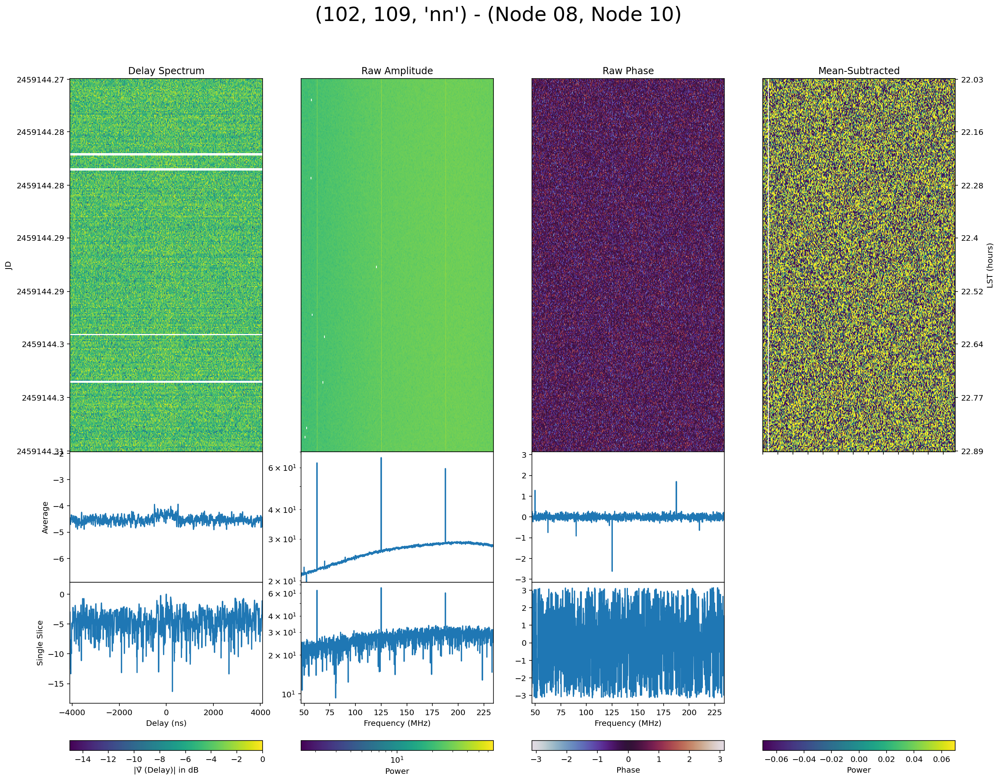

109_110_nn.pdf


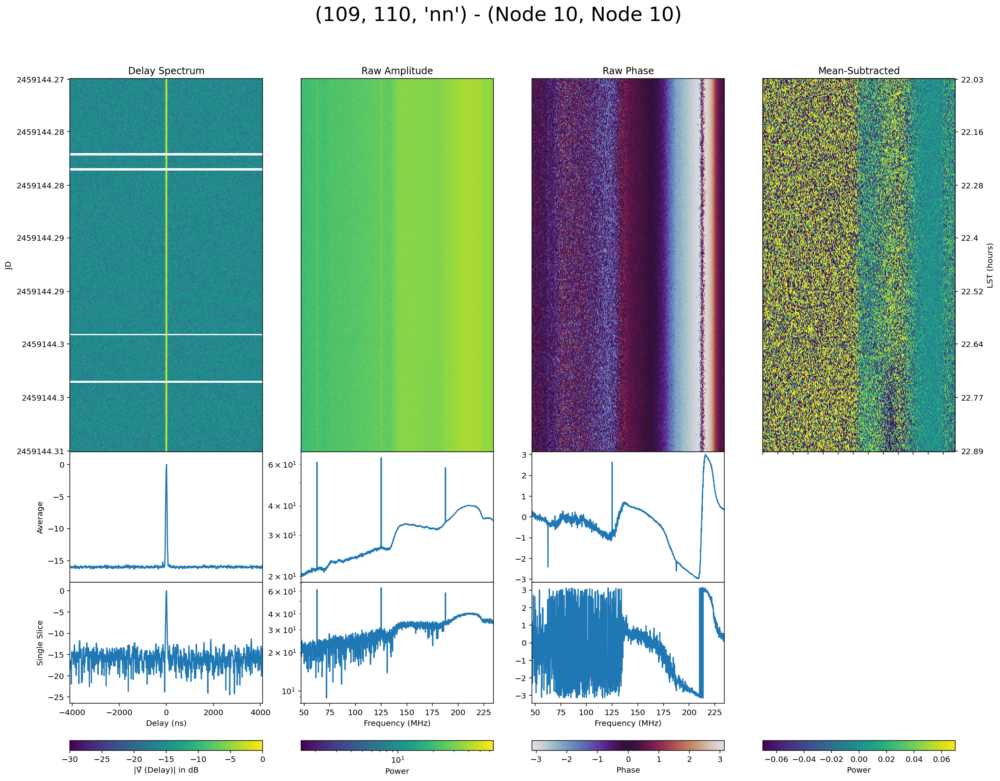

109_109_nn.pdf


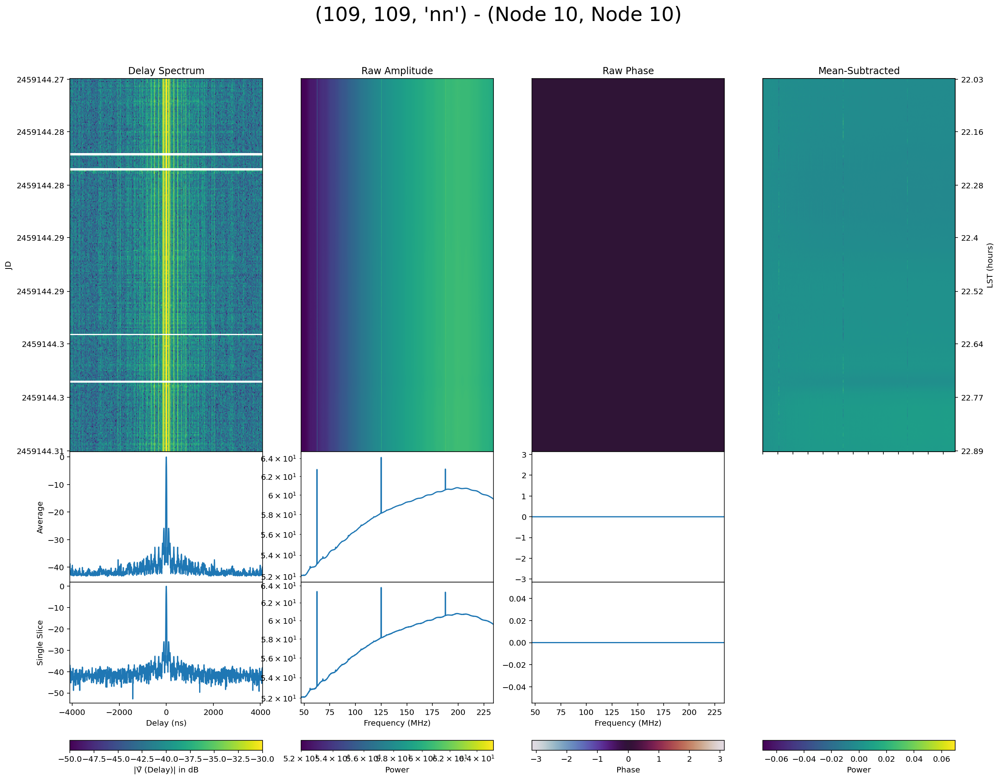

In [111]:
for bl in bls:
        title = f'{bl[0]}_{bl[1]}_{bl[2]}.pdf'
        print(title)
        auto_waterfall_lineplot(uvd, bl, jd, auto_update, auto_flagged_update, ds_update, dff_update,
                                    taus, _data_cleaned_sq, colorbar_min=1e6, colorbar_max=1e8, title=title,
                                    outdir=outdir,savefig=False)

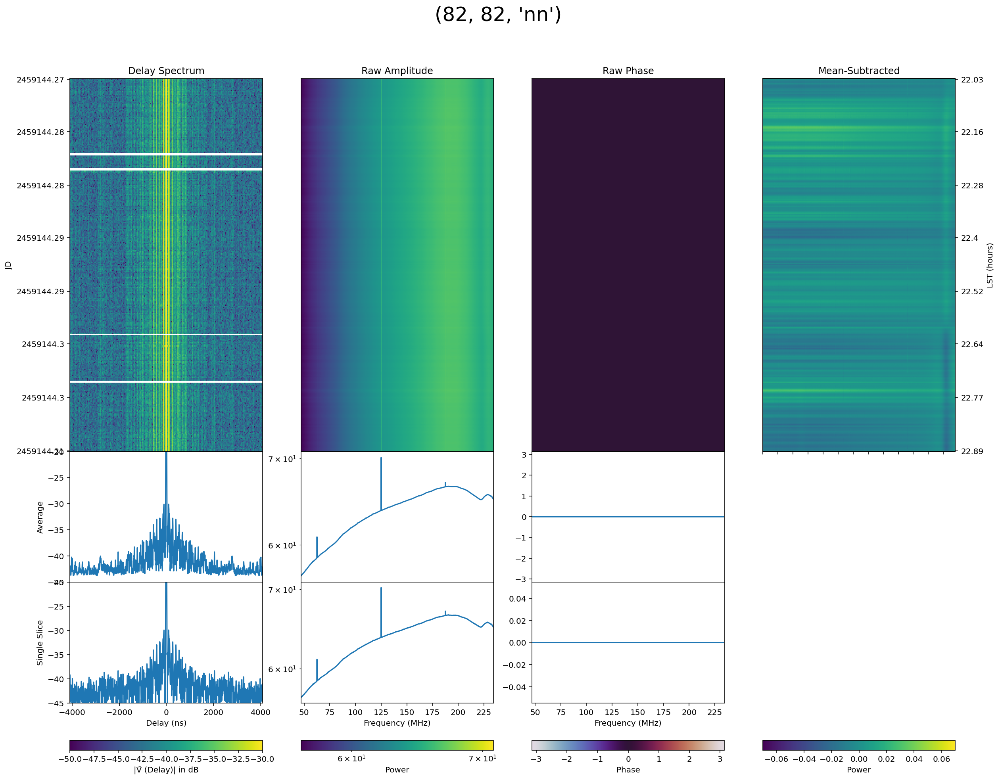

In [37]:
bl = (82,82,'nn')
jd = 2459144
auto_waterfall_lineplot(uvd, bl, jd, auto_update, auto_flagged_update, ds_update, dff_update,
                            taus, _data_cleaned_sq, colorbar_min=1e6, colorbar_max=1e8, title='')

In [ ]:
freqs = uvd.freq_array[0]*1e-6
for bl in bls:
    if bl[2] == 'ee':
        continue
    a1 = bl[0]
    a2 = bl[1]
    for pol in ['ee','nn']:
        key = (a1,a2,pol)
        fig, ax = plt.subplots(1,5,figsize=(20,12))
        fig.suptitle(f'({a1},{a2},{pol})')

        ax[0].plot(freqs,10*np.log10(np.mean(np.abs(uvd.get_data(key)),axis=0)))
        ax[0].set_xlabel('Freq (MHz)')
        ax[0].set_ylabel('10*log10|V|')
        ax[0].set_title('Raw Spectrum')
        
        ax[1].plot(taus,ds_update,label='Delay Spectrum')
        ax[1].plot(taus,dff_update,label='Noise from Diff')
        ax[1].set_xlabel('𝜏 (ns)')
        ax[1].set_ylabel('|Ṽ (𝜏)| in dB')
        ax[1].set_title('Delay Spectrum')
        ax[1].legend()
        
        im = ax[2].imshow(10*np.log10(np.abs(uvd.get_data(key))), aspect='auto', cmap='plasma')
        fig.colorbar(im)
        ax[2].set_title()

In [4]:
def calc_html_dspec(HHfiles, html_filename, bls, uvd, uvd_diff, _data_cleaned_sq, data_rs_sq, JD):

    freqs = uvd.freq_array[0]

    FM_idx = np.searchsorted(freqs*1e-6, [85,110])
    flag_FM = np.zeros(freqs.size, dtype=bool)
    flag_FM[FM_idx[0]:FM_idx[1]] = True

    pols = ['nn', 'ee']
    freqs1 = [40, 50, 120, 155, 190]
    freqs2 = [250, 85, 155, 190, 225]
    freq_range = freqs1+freqs2

    _data_sq_sub = {}
    data_rs_sq_sub = {}
    for freq1, freq2 in zip(freqs1, freqs2):
        print(f'Calculating freqs ({freq1},{freq2})')
        if(freq1 == 40):
            _data_sq_sub[(freq1, freq2)] = _data_cleaned_sq
            data_rs_sq_sub[(freq1, freq2)] = data_rs_sq
        else:
            _d_sq_sub, d_rs_sq_sub = utils.clean_ds(HHfiles, bls, uvd, uvd_diff, freq_range=[freq1, freq2], pols=['nn','ee'])
            _data_sq_sub[(freq1, freq2)] = _d_sq_sub
            data_rs_sq_sub[(freq1, freq2)] = d_rs_sq_sub
    return freqs1, freqs2, freq_range, _data_sq_sub, data_rs_sq_sub, flag_FM

def plot_html_dspec(HHfiles, html_filename, bls, uvd, uvd_diff, _data_cleaned_sq, data_rs_sq, JD,
                   freqs1, freqs2, freq_range, _data_sq_sub, data_rs_sq_sub, flag_FM):
    if bls is None or len(bls) == 0:
        bls = [(ant, ant) for ant in uvd.get_ants()]
    freqs = uvd.freq_array[0]
    pols = ['nn', 'ee']
    nodes, antDict, inclNodes = utils.generate_nodeDict(uvd)

    data_full = []
    wgts_full = []
    taus_full = []
    _data_full = []
    _diff_full = []
    _diff_full2 = []
    N_xaxis = []
    N_aggr = [0]
    keys = []
    print('Doing per-baseline calculations')
    for i, bl in enumerate(bls):
        for j, pol in enumerate(pols):
            key = (bl[0],bl[1],pol)
            n0 = int(antDict[bl[0]]['node'])
            s0 = antDict[bl[0]]['snapLocs'][0]
            n1 = int(antDict[bl[1]]['node'])
            s1 = antDict[bl[1]]['snapLocs'][0]
            keys.append(f'{key}: (N{n0} S{s0}, N{n1} S{s1})')
            auto = np.abs(uvd.get_data(key))
            auto /= np.median(auto, axis=1)[:,np.newaxis]
            auto[np.isinf(auto)] = np.nan
            auto_ave = np.nanmean(auto, axis=0, dtype=np.float32)

            wgts = (~uvd.get_flags(key)*~flag_FM[np.newaxis,:]).astype(np.float32)
            wgts_ave = np.mean(wgts, axis=0)
            wgts_ave = np.where(wgts_ave > 0.8, 1, 0)

            if(np.isnan(np.mean(auto_ave)) != True):
                data_full = data_full + list(auto_ave)
            else:
                data_full = data_full + list(np.isnan(auto_ave).astype(float))
            wgts_full = wgts_full + list(wgts_ave)

            for freq1, freq2 in zip(freqs1, freqs2):
                _data_ave = np.sqrt(np.abs(np.nanmean(_data_sq_sub[(freq1,freq2)][key], axis=0))).astype(np.float32)
                idx_freq = np.where(np.logical_and(freqs*1e-6 > freq1, freqs*1e-6 < freq2))[0]
            
                win = dspec.gen_window('bh7', idx_freq.size)
                _diff = np.fft.fftshift(np.fft.ifft(uvd_diff.get_data(key)[:,idx_freq]*win), axes=1)
#                 _diff_ave = np.abs(np.mean(_diff, axis=0)).astype(np.float32)
                _diff_ave = np.sqrt(np.abs(np.mean(_diff.conj()*_diff, axis=0))/(_diff.shape[0])).astype(np.float32)
#                 _diff_ave = np.sqrt(np.abs(_diff.conj()*_diff)[0]/(_diff.shape[0])).astype(np.float32)

                if(np.isnan(np.mean(_data_ave)) != True and np.mean(_data_ave) != 0):
                    _data_full = _data_full + list(10*np.log10(_data_ave/_data_ave.max()))
                    _diff_full = _diff_full + list(10*np.log10(_diff_ave/_data_ave.max()))
                else:
                    _data_full = _data_full + list(np.isnan(_data_ave).astype(float))
                    _diff_full = _diff_full + list(np.isnan(_diff_ave).astype(float))

                if(i == 0 and j == 0):
                    freqs_sub = freqs[idx_freq]
                    taus_sub = np.float32(np.fft.fftshift(np.fft.fftfreq(freqs_sub.size, np.diff(freqs_sub)[0])))
                    taus_full = taus_full + list(taus_sub*1e9)
                    N_xaxis.append(len(freqs_sub))
                    N_aggr.append(np.sum(N_xaxis))

    x_le = taus_full[:freqs.size]
    ds_update = _data_full[:freqs.size]
    dff_update = _diff_full[:freqs.size]
    x_ri = freqs/1e6
    auto_update = np.log10(data_full[:freqs.size])
    auto_flagged_update = np.array(auto_update, dtype=np.float32)/np.array(wgts_full[:freqs.size], dtype=np.float32)-0.1

    source = ColumnDataSource(data=dict(x_le=x_le, ds_update=ds_update, dff_update=dff_update, N_xaxis=N_xaxis, N_aggr=N_aggr, 
                                        taus_full=taus_full, _data_full=_data_full, _diff_full=_diff_full,
                                        x_ri=x_ri, auto_update=auto_update, auto_flagged_update=auto_flagged_update,
                                        data_full=data_full, wgts_full=wgts_full))

    plot1 = figure(title="Delay spectrum", x_range=(0, 4500), y_range=(-60, 0), plot_width=450, plot_height=400, output_backend="canvas")
    plot1.line('x_le', 'ds_update', source=source, color='#1f77b4', line_width=2, alpha=0.8, legend_label='delay spectrum')
    plot1.line('x_le', 'dff_update', source=source, color='red', line_width=1.5, alpha=0.8, legend_label='noise from diff')
    plot1.xaxis.axis_label = '𝜏 (ns)'
    plot1.yaxis.axis_label = '|Ṽ (𝜏)| in dB'

    plot2 = figure(title="Raw Spectrum", y_range=(-0.6, 0.4), x_range=Range1d(start=freqs.min()/1e6, end=freqs.max()/1e6), plot_width=450, plot_height=400, output_backend="canvas")
    plot2.line('x_ri', 'auto_update', source=source, color='#ff7f0e', line_width=2, alpha=0.8, legend_label='unflagged')
    plot2.line('x_ri', 'auto_flagged_update', source=source, color='#1f77b4', line_width=2, alpha=0.8, legend_label='flagged')
    plot2.xaxis.axis_label = '𝜈 (MHz)'
    plot2.yaxis.axis_label = 'log10(|V(𝜈)|)'

    radio_button = RadioButtonGroup(labels=["Full band", "50-85 MHz", "120-155 MHz", "155-190 MHz", "190-225 MHz"], active=0)
    select = Select(title="key:", value=keys[0], options=keys, width=300)

    callback = CustomJS(args=dict(source=source, select=select, radio_button=radio_button, xr=plot2.x_range),
                        code="""
        var data = source.data;
        var active = radio_button.active;
        var key = select.value;
        var keys = select.options;
        var x_le = [];
        var y1_le = [];
        var y2_le = [];
        var y1_ri = [];
        var y2_ri = [];
        var N_xaxis = data['N_xaxis'];
        var N_aggr = data['N_aggr'];
        var taus_full = data['taus_full'];
        var _data_full = data['_data_full'];
        var _diff_full = data['_diff_full'];
        var x_ri = data['x_ri']
        var data_full = data['data_full']
        var wgts_full = data['wgts_full']
        for (var i = 0; i < keys.length; i++) {
            if (key == keys[i]) {
                for (j = 0; j < N_xaxis[active]; j++) {
                    x_le.push(taus_full[N_aggr[active]+j]);
                    y1_le.push(_data_full[N_aggr[5]*i+N_aggr[active]+j]);
                    y2_le.push(_diff_full[N_aggr[5]*i+N_aggr[active]+j]);
                }
                for (var j = 0; j < x_ri.length; j++) {
                    y1_ri.push(Math.log10(data_full[x_ri.length*i+j]));
                    y2_ri.push(Math.log10(data_full[x_ri.length*i+j])/wgts_full[x_ri.length*i+j]-0.1);
                }
            }
        }
        data['x_le'] = x_le;
        data['ds_update'] = y1_le;
        data['dff_update'] = y2_le;
        data['auto_update'] = y1_ri;
        data['auto_flagged_update'] = y2_ri;
        if (active == 0) {
            var start = 46.92
            var end = 234.30
        }
        else if (active == 1) {
            var start = 50
            var end = 85
        }
        else {
            var start = 120+(active-2)*35
            var end = 120+(active-1)*35
        }
        xr.setv({"start": start, "end": end})
        source.change.emit();
    """)

    radio_button.js_on_change('active', callback)
    select.js_on_change('value', callback)
    plot2.x_range.js_on_change('start', callback)
    plot2.x_range.js_on_change('end', callback)


    layout = column(
        row(plot1, plot2),
        select,
        column(radio_button)
    )

    output_file(html_filename, title="delay_spectrum_JD{}".format(JD))

    show(layout)
    
    return auto_update, auto_flagged_update, ds_update, dff_update, x_le

102_109_nn.pdf


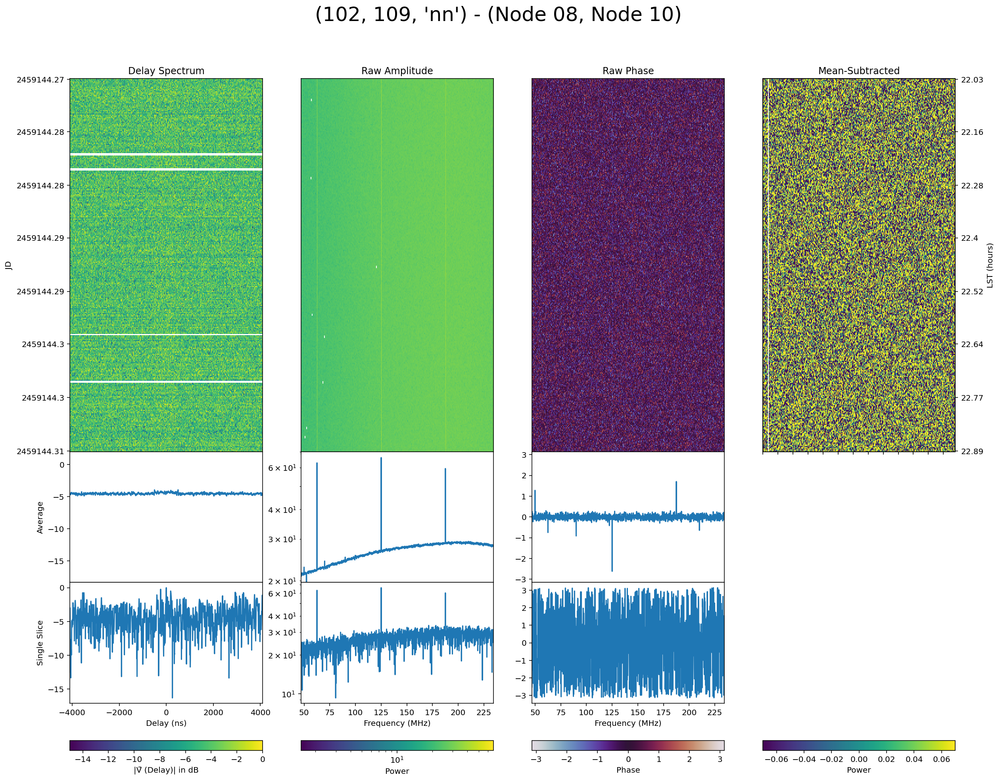

109_110_nn.pdf


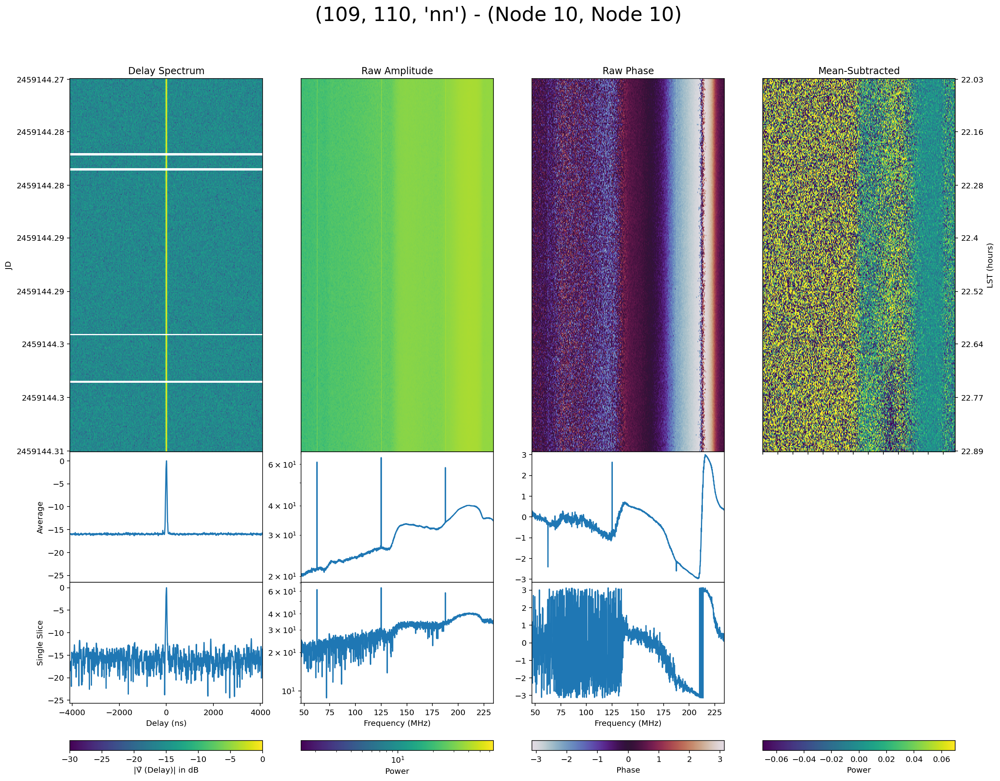

109_109_nn.pdf


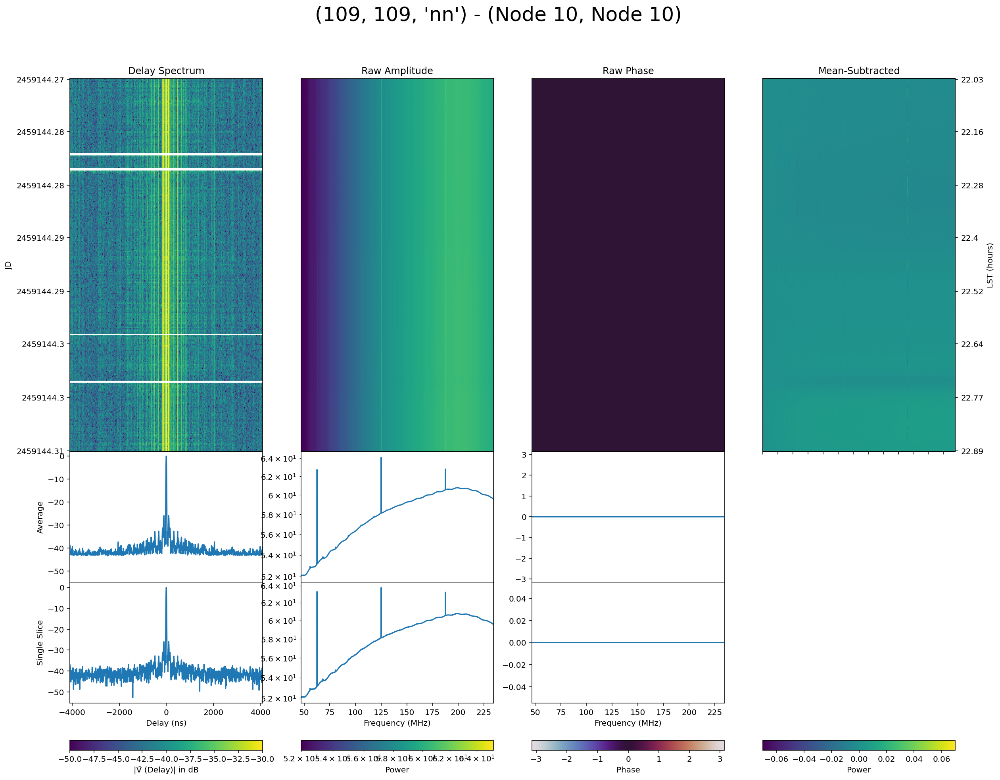

In [109]:
ant = 109
# auto_update, auto_flagged_update, ds_update, dff_update, taus = plot_html_dspec(HHfiles[100:260], html_filename, bls, uvd, uvd_diff, _data_cleaned_sq, data_rs_sq, JD, freqs1, freqs2, freq_range, _data_sq_sub, data_rs_sq_sub, flag_FM)

jd = 2459144
bls = [(102,109,'nn'),(109,110,'nn'),(109,109,'nn')]
for bl in bls:
    title = f'{bl[0]}_{bl[1]}_{bl[2]}.pdf'
    print(title)
    auto_waterfall_lineplot(uvd, bl, jd, auto_update, auto_flagged_update, ds_update, dff_update,
                                taus, _data_cleaned_sq, colorbar_min=1e6, colorbar_max=1e8, title=title,
                                outdir=outdir,savefig=False)

In [5]:
def corr_spectra_cross_plot(uvd, bls, jd, corr, auto_update, auto_flagged_update, ds_update, dff_update,
                            taus, _data_cleaned_sq, colorbar_min=1e6, colorbar_max=1e8, title='',
                           outdir = '',savefig=True):
    freqs = uvd.freq_array[0]*1e-6
    fig = plt.figure(figsize=(20,6*len(bls)))
    hrats = np.tile([1,1,0.1],len(bls))
    gs = fig.add_gridspec(len(bls)*3, 6, width_ratios=[0.1,1,1,1,1,0.03], height_ratios=hrats,
                          hspace=0.2,wspace=0.15,left=0.1)
    cmap = plt.get_cmap('plasma')
    bl_lengths = {}
    max_l = 0
    antpos, ants = uvd.get_ENU_antpos()
    for bl in bls:
        a1pos = antpos[np.argwhere(ants==bl[0])]
        a2pos = antpos[np.argwhere(ants==bl[1])]
        length = np.sqrt(np.sum(np.square(a1pos-a2pos)))
        bl_lengths[bl] = length
        if length > max_l:
            max_l = length
    
    for i,bl in enumerate(bls):
        for p,pol in enumerate(['ee','nn']):
            nodes, antDict, inclNodes = utils.generate_nodeDict(uvd)
            node1 = antDict[bl[0]]['node']
            node2 = antDict[bl[1]]['node']

            a1 = bl[0]
            a2 = bl[1]
            bl = (a1,a2,pol)

            ds = 10.*np.log10(np.sqrt(np.abs(_data_cleaned_sq[bl])/np.abs(_data_cleaned_sq[bl]).max(axis=1)[:,np.newaxis]))

            line0 = fig.add_subplot(gs[i*3+p,0])
#             if i==0 and p==0:
#                 line0.set_title('corr')
            line0.set_xticks([])
            line0.set_yticks([])
            if node1==node2:
                color='lightgreen'
            else:
                color='powderblue'
            line0.set_ylabel(bl,fontsize=15, backgroundcolor=color)
            line0.imshow(np.tile(corr[bl],(10,2)),vmin=0.01,vmax=1,cmap='plasma',norm=colors.LogNorm(vmin=0,vmax=1))
            line0.set_title(np.around(corr[bl],2))

            line = fig.add_subplot(gs[i*3+p,1])
            averaged_ds = np.nanmean(ds, axis=0)
            plt.plot(taus,averaged_ds)
            if i==0 and p==0:
                line.set_title('Delay Spectrum')
            if p==0:
                line.set_xticks([])
            line.set_xlim(taus[0],taus[-1])
            line.set_ylim(np.nanmin(averaged_ds)-2,np.nanmax(averaged_ds)+2)
            if bl == bls[-1]:
                line.set_xlabel('Delay (ns)')

            plt.subplots_adjust(hspace=.0)

            # Plot raw spectrum
            plots = ['Raw Amplitude','Raw Phase','Mean-Subtracted']

            d = uvd.get_data((a1,a2, pol))
            vabs = np.average(10*np.log10(np.abs(d)),axis=0)
            line2 = fig.add_subplot(gs[i*3+p,2])
            line2.plot(freqs,vabs)
            if i==0 and p==0:
                line2.set_title('Raw Abs')
            if p==0:
                line2.set_xticks([])
            line2.set_yticks([])
            line2.set_yscale('log')
            line2.set_yticks([])
            line2.set_yticklabels([])
            line2.set_xlim(freqs[0],freqs[-1])
            if bl == bls[-1]:
                line2.set_xlabel('Frequency (MHz)')
            line2.set_yticks([])

            vreal = np.average(np.abs(np.real(d)),axis=0)
            line3 = fig.add_subplot(gs[i*3+p,3])
            line3.plot(freqs,vreal)
            if i==0 and p==0:
                line3.set_title('Raw Real')
            if p==0:
                line3.set_xticks([])
            line3.set_yscale('log')
            line3.set_xlim(freqs[0],freqs[-1])
            line3.set_ylim(np.nanmin(vreal),np.nanmax(vreal))
            if bl == bls[-1]:
                line3.set_xlabel('Frequency (MHz)')
            line3.set_yticks([])

            vphase = np.average(np.angle(d),axis=0)
            line4 = fig.add_subplot(gs[i*3+p,4])
            line4.plot(freqs,vphase)
            if i==0 and p==0:
                line4.set_title('Raw Phase')
            if p==0:
                line4.set_xticks([])
            line4.set_ylim(-np.pi,np.pi)
            line4.set_xlim(freqs[0],freqs[-1])
            if bl == bls[-1]:
                line4.set_xlabel('Frequency (MHz)')
        if i < len(bls):        
            line5 = fig.add_subplot(gs[i*3+2,0:5])
            line5.imshow(np.tile(0,(10,10)),cmap='magma',vmin=0,vmax=1,aspect='auto')
            line5.set_xticks([])
            line5.set_yticks([])
        line6 = fig.add_subplot(gs[i*3:i*3+2,5])
        line6.set_xticks([])
        line6.set_yticks([])
        line6.axvline(ymin=0,ymax=bl_lengths[bl]/max_l,linewidth=15)
        line6.axis('off')
#         line6.spines["top"].set_visible(False)
#         line6.spines["right"].set_visible(False)
#         line6.spines["bottom"].set_visible(False)
#         line6.yaxis.set_label_position("right")
        line6.set_ylabel('bl length')

    if savefig is True:
        plt.savefig(f'{outdir}/{title}',dpi=500, bbox_inches = 'tight',pad_inches = 0.1)
    else:
        plt.show()
    plt.close()

In [6]:
def auto_waterfall_lineplot_multi(uvd, bls, jd, auto_update, auto_flagged_update, ds_update, dff_update,
                            taus, _data_cleaned_sq, colorbar_min=1e6, colorbar_max=1e8, title=''):
    freqs = uvd.freq_array[0]*1e-6
    fig = plt.figure(figsize=(20,16))
    for i,bl in enumerate(bls):
        gs = gridspec.GridSpec(3, 4, height_ratios=[2,0.7,1])
        it = 0
        times= np.unique(uvd.time_array)

        nodes, antDict, inclNodes = utils.generate_nodeDict(uvd)
        node1 = antDict[bl[0]]['node']
        node2 = antDict[bl[1]]['node']

        a1 = bl[0]
        a2 = bl[1]
        pol = bl[2]

        # Plot Delay Spectra
        waterfall= fig.add_subplot(gs[0])
        jd_ax=plt.gca()
        if a1 == a2:
            vmax = -30
            vmin = -50
        else:
            vmax = 0
            vmin = -30
        ds = 10.*np.log10(np.sqrt(np.abs(_data_cleaned_sq[bl])/np.abs(_data_cleaned_sq[bl]).max(axis=1)[:,np.newaxis]))
        im = plt.imshow(ds, aspect='auto', interpolation='nearest', vmin=vmin, vmax=vmax)
        waterfall.set_title('Delay Spectrum')
        xticks = np.arange(0, len(taus), 120)
        xlabels = [np.around(taus[x],2) for x in xticks]
        xlabels = np.around(xlabels,2)
        plt.xticks(xticks, labels = xlabels)

        jd_ax.set_ylabel('JD')
        jd_yticks = [int(i) for i in np.linspace(0,len(times)-1,8)]
        jd_labels = np.around(times[jd_yticks],2)
        jd_ax.set_yticks(jd_yticks)
        jd_ax.set_yticklabels(jd_labels)
        jd_ax.autoscale(False)

        line = plt.subplot(gs[4])
        averaged_ds = np.nanmean(ds, axis=0)
        plt.plot(taus,averaged_ds)
        line.set_ylim(np.nanmin(averaged_ds)-2,np.nanmax(averaged_ds)+2)
    #     line.set_ylim(-16,-10)
    #     line.set_ylim(-50,-30)
    #     line.set_yscale('log')
        line.set_ylabel('Average')
        line.set_xlim(taus[0],taus[-1])
        line.set_xticks([])

        line2 = plt.subplot(gs[8])
        ds_mid = ds[len(ds)//2,:]
        plt.plot(taus,ds_mid)
    #     line2.set_ylim(-25,-5)
    #     line2.set_yscale('log')
        line2.set_ylim(np.nanmin(ds_mid)-2,np.nanmax(ds_mid)+2)
        line2.set_xlabel('Delay (ns)')
        line2.set_ylabel('Single Slice')
        line2.set_xlim(taus[0],taus[-1])

#         if a1 == a2:
#             line.set_ylim(-45,-20)
#             line2.set_ylim(-45,-20)
#         else:
#             line.set_ylim(-16,-10)
#             line2.set_ylim(-25,-5)

        plt.setp(waterfall.get_xticklabels(), visible=False)
        plt.subplots_adjust(hspace=.0)
        cbar = plt.colorbar(im, pad= 0.2, orientation = 'horizontal')
        cbar.set_label('|Ṽ (Delay)| in dB')

        # Plot raw spectrum
        plots = ['Raw Amplitude','Raw Phase','Mean-Subtracted']
        for i,p in enumerate(plots):
            waterfall= plt.subplot(gs[i+1])
            jd_ax=plt.gca()
            d = uvd.get_data((a1,a2, pol))
            if i==0:
                dat = 10*np.log10(np.abs(d))
                im = plt.imshow(dat,norm=colors.LogNorm(), 
                        aspect='auto')
            elif i==1:
                dat = np.angle(d)
                im = plt.imshow(dat,aspect='auto', cmap='twilight', vmin=-np.pi, vmax=np.pi)
            elif i==2:
                dat = np.log10(np.abs(d))
                dat = np.subtract(dat,np.nanmean(dat,axis=0))
                im = plt.imshow(dat,aspect='auto',vmin=-0.07,vmax=0.07,cmap='viridis')
            waterfall.set_title(plots[i])
            xticks = np.arange(0, len(freqs), 120)
            plt.xticks(xticks, labels =np.around(freqs[xticks],2))
            jd_ax.set_yticks([])

            if i==2:
                lst_ax = jd_ax.twinx()
                lst_ax.set_ylabel('LST (hours)')
                lsts = uvd.lst_array*3.819719
                inds = np.unique(lsts,return_index=True)[1]
                lsts = [lsts[ind] for ind in sorted(inds)]
                lst_yticks = [int(i) for i in np.linspace(0,len(lsts)-1,8)]
                lst_labels = np.around([lsts[i] for i in lst_yticks],2)
                lst_ax.set_yticks(lst_yticks)
                lst_ax.set_yticklabels(lst_labels)
                lst_ax.set_ylim(jd_ax.get_ylim())
                lst_ax.autoscale(False)

            if i<2:
                line= plt.subplot(gs[i+5])
                averaged_data = np.average(dat, axis=0)
                plt.plot(freqs,averaged_data)
                if i == 0:
                    line.set_yscale('log')
                else:
                    line.set_ylim(-np.pi,np.pi)
                line.set_xlim(freqs[0],freqs[-1])
                line.set_xticks([])

                line2 = plt.subplot(gs[i+9])
                dat = dat[len(dat)//2,:]
                plt.plot(freqs,dat)
                if i == 0:
                    line2.set_yscale('log')
                else:
                    line.set_ylim(-np.pi,np.pi)
                line2.set_xlabel('Frequency (MHz)')
                line2.set_xlim(freqs[0],freqs[-1])
            else:
                line2 = plt.subplot(gs[i+9])
                line2.axis('off')

            plt.setp(waterfall.get_xticklabels(), visible=False)
            plt.subplots_adjust(hspace=.0)
            cbar = plt.colorbar(im, pad= 0.2, orientation = 'horizontal')
            if i==1:
                cbar.set_label('Phase')
            else:
                cbar.set_label('Power')

        fig.suptitle(bl, fontsize=25 ,y=0.96)
        plt.annotate(title, xy=(0.5,0.94), ha='center',xycoords='figure fraction')
        plt.show()
        plt.close()
    plt.savefig('testing.png')

In [19]:
h = cm_hookup.Hookup()
x = h.get_hookup('HH')

In [26]:
key = 'HH83:A'
# p = x[key].get_part_from_type('node')['E<ground'][1:]
p = x[key].get_part_from_type('post-amp')

In [27]:
int(p['E<ground'][3:])

58

In [31]:
ants = [81,82,83,100,119,138,98,99,116,117,118,137]
pams = []
for a in ants:
    key = f'HH{a}:A'
    p = x[key].get_part_from_type('post-amp')['E<ground'][3:]
    print(int(p))
    pams.append(int(p))

53
54
58
56
57
55
59
60
61
62
63
49


In [32]:
sorted_ants = []
for i,p in enumerate(sorted(pams)):
    for j,a in enumerate(ants):
        key = f'HH{a}:A'
        pam = x[key].get_part_from_type('post-amp')['E<ground'][3:]
        if int(pam) == p:
            sorted_ants.append(a)
print(sorted_ants)

[137, 81, 82, 138, 100, 119, 83, 98, 99, 116, 117, 118]


In [33]:
def calc_corr_metric(uvd_sum,bls,uvd_diff=None):
    corr = {}
    for bl in bls:
        a1 = bl[0]
        a2 = bl[1]
        if uvd_diff == None:
            dat = uvd_sum.get_data(bl)
            s = dat[0::2]
            d = dat[1::2]
        else:
            s = uvd_sum.get_data(bl)
            d = uvd_diff.get_data(bl)
        even = (s + d)/2
        even = np.divide(even,np.abs(even))
        odd = (s - d)/2
        odd = np.divide(odd,np.abs(odd))
        product = np.multiply(even,np.conj(odd))
        corr[bl] = np.abs(np.nanmean(product))
    return corr

In [ ]:
# ants = [81,82,83,100]
outdir = '/lustre/aoc/projects/hera/dstorer/Projects/highDelayFeature/loadAnalysis/smithCharts'
antsN7 = [81,82,83,100,119,138,98,99,116,117,118,137]
# antsN10 = [82,93,94,109,110,111,112,127,128,129,130]
# ants = antsN10
# # antsN14 = [165,166,184,185,186,187,163,164,143,144,145]
# # antsN15 = [147,148,149,168,169,170,189,190,191]

ants = antsN7
# ants = [137, 81, 82, 138, 100, 119, 83, 98, 99, 116, 117, 118]
# HHfiles, difffiles, HHautos, diffautos, uvdx, uvdy = utils.load_data(data_path,JD)
    
# uvd = UVData()
# uvd_diff = UVData()
# unread = True
# i=0
# while unread and i<len(HHautos):
#     try:
#         uvd.read(HHautos[i])
#         unread = False
#     except:
#         i += 1
#         continue
# print('Reading Sums')
# uvd.read(HHfiles[160:260], skip_bad_files=True, antenna_nums=ants)
print('Reading Diffs')
uvd_diff.read(difffiles[160:260], skip_bad_files=True, antenna_nums=ants)
outdir = '/lustre/aoc/projects/hera/dstorer/Projects/highDelayFeature/loadAnalysis/smithCharts'

lsts = uvd.lst_array
nodes, antDict, inclNodes = utils.generate_nodeDict(uvd)

fig = plt.figure(figsize=(50,50))
gs = fig.add_gridspec(len(ants),len(ants),hspace=0.25,wspace=0.2,left=0.1)
pol = 'xx'
corr = calc_corr_metric(uvd,uvd_diff,bls=[(a1,a2) for a1 in ants for a2 in ants])
corrmap = plt.get_cmap('plasma')
# corrmap.set_norm(norm=colors.LogNorm())
nodes, antDict, inclNodes = utils.generate_nodeDict(uvd)
for i,a1 in enumerate(ants):
    print(a1)
    for j,a2 in enumerate(ants):
        s1 = antDict[a1]['snapLocs'][0]
        s2 = antDict[a2]['snapLocs'][0]
        sin1 = antDict[a1]['snapInput'][0]
        sin2 = antDict[a2]['snapInput'][0]
        key1 = f'HH{a1}:A'
        p1 = int(x[key1].get_part_from_type('post-amp')['E<ground'][3:])
        key2 = f'HH{a1}:A'
        p2 = int(x[key2].get_part_from_type('post-amp')['E<ground'][3:])
        d = uvd.get_data(a1,a2,pol)
        freqs = uvd.freq_array[0]*1e-6
        c = corr[(a1,a2)]
        if i <= j:
            davg = np.average(d,axis=0)
            r = np.abs(davg)
            theta = np.angle(davg)
            min10 = np.log10(np.min(r))
            max10 = np.log10(np.max(r))
            r = np.log10(r) - min10
            ax = fig.add_subplot(gs[i,j],polar=True)
            im = ax.scatter(theta,r,c =freqs, cmap='viridis',s=20)
            ax.set_rlim(0,np.percentile(r,99.5))
            ax.set_rticks([])
            if a2 == ants[-1]:
                fig.colorbar(im)
            ax.set_ylabel('Re')
            ax.set_xlabel('Im')
            ax.set_xticklabels([])
        else:
            ax = fig.add_subplot(gs[i,j])
            im = ax.imshow(np.angle(d),cmap='twilight',vmin=-np.pi,vmax=np.pi,aspect='auto')
            if a1 == ants[-1]:
                fig.colorbar(im,orientation='horizontal')
                ax.set_xlabel('Frequency')
            else:
                ax.set_xticks([])
            ax.set_yticks([])
            if a2 == ants[0]:
                ax.set_ylabel('Time')
        if c < 0.3:
            ax.set_title(f'({a1},{a2}) - (S{s1}-{sin1}, S{s2}-{sin2}) - (P{p1}, P{p2})',backgroundcolor=corrmap(c),color='w')
        else:
            ax.set_title(f'({a1},{a2}) - (S{s1}-{sin1}, S{s2}-{sin2}) - (P{p1}, P{p2})',backgroundcolor=corrmap(c),color='black')
fig.suptitle('Node 7 - NN')
plt.savefig(f'{outdir}/Node7_smithChart_lowRes.pdf',dpi=300)
plt.close()
# plt.show()

Reading Diffs


In [37]:
print(outdir)

/lustre/aoc/projects/hera/dstorer/Projects/highDelayFeature/loadAnalysis/highCorrCrossesAll


In [39]:
nodes['07']['ants']

[81, 82, 83, 98, 99, 100, 116, 117, 118, 119, 137, 138]

In [41]:
for node in nodes:
    print(nodes[node].keys())

dict_keys(['ants', 'snapLocs', 'snapInput'])
